In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import cv2

import db
import pam
import utils as ut
import features as ft
import dtw
import clustering_evaluation as ce
import seq2seq2 as s2s
from numpy.linalg import inv
import transform_space as ts
import time
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans,AgglomerativeClustering
from sklearn.metrics import pairwise_distances,homogeneity_completeness_v_measure,silhouette_score,calinski_harabaz_score


In [2]:
DATA_PATH = "data/grl/"
DATA_BASE = DATA_PATH + "grl.sqlite"
SAVE_PATH = DATA_PATH + "generated_data/"
FRAME_PATH = DATA_PATH + "grl.png"
VIDEO_PATH = DATA_PATH + "grl.MOV"
HOMOGRAPHY = DATA_PATH + "homography.txt"
DISTANCES = SAVE_PATH + "distances/cityblock_50.txt"

# Evaluation

## Supervized

In [7]:
nb_trajectories_per_object_sup = 5
trajectories_po_sup,ids_po_sup = db.filter_trajectories(nb_trajectories_per_object_sup, trajectories_po, ids_po)

#select subset of objects randomly
selected_objects = np.array(trajectories_po_sup)
selected_objects_ids = np.array(ids_po_sup)

nb_selected_objects = 20
np.random.seed(0)
ids_s = np.random.choice(np.arange(nb_objects),nb_selected_objects,replace = False)

selected_objects = selected_objects[ids_s]
selected_objects_ids = selected_objects_ids[ids_s]
#total number of selected trajectories
nb_trajectories_sup = nb_trajectories_per_object_sup * nb_selected_objects

pixel_trajectories_po_sup = [[ut.to_pixel(t,HOMOGRAPHY) for t in trajectories] for trajectories in selected_objects]


# list of every selected trajectory, 
trajectories_sup = [t for o in selected_objects for t in o]
# ids of every selected trajectory
ids_sup = [i for o in selected_objects_ids for i in o]
# trajectories in pixel space, for displaying purposes only
pixel_trajectories_sup = [ut.to_pixel(t,HOMOGRAPHY) for t in trajectories_sup]

In [8]:
trajectories_sup= [[t[-i] for i in range(1,len(t)+1)] for t in trajectories_sup ]

In [9]:
#trajectories_sup,_,_ = ts.transform_original_space(trajectories_sup)
discretized_trajectory_sup,nb_label,nb_row,nb_col,input_size  = ts.discretize_trajectories(trajectories_sup,w,h,s = 5)
input_data_sup, sos = ts.one_hot_encode_states_eos(nb_label,discretized_trajectory_sup)
input_data_sup,_ = ts.minmax_scaling(input_data_sup,minmax_scaler)
features_sup = s2s.unify_trajectory_sizes(encoder,input_data_sup,input_size = input_size)

ValueError: unknown categorical feature present [124] during transform.

In [9]:
pca_sup = PCA(n_components=0.99)
features_pca_sup = pca_sup.fit_transform(features_sup)
pca_sup.n_components_

11

In [10]:
labels_true = ce.get_ground_truth(ids_sup,selected_objects_ids)

In [11]:
nb_clusters = nb_selected_objects

### Kmeans

In [12]:
best_random_state = ce.best_model_rand_init(100,features_pca_sup,labels_true,nb_clusters)

clusters = KMeans(n_clusters=nb_clusters, random_state = best_random_state).fit_predict(features_pca_sup)

(1.0, 1.0, 1.0)


### Hierarchical

In [13]:
clusters = AgglomerativeClustering(n_clusters = nb_clusters).fit_predict(features_pca_sup)
homogeneity_completeness_v_measure(labels_true, clusters)

(1.0, 1.0, 1.0)

### PAM

In [14]:
start = time.time()

distance_matrix = pairwise_distances(features_pca_sup,metric="manhattan")
medoids_idx, clusters =pam.pam(distance_matrix, nb_clusters)

print(time.time() - start)
homogeneity_completeness_v_measure(labels_true, clusters)

0.00298094749451


(1.0, 1.0, 1.0)

## Unupervized

In [3]:
trajectories_po,ids_po,nb_objects = db.get_trajectories_by_object(DATA_BASE)
nb_trajectories_per_object = 1
trajectories_po,ids_po = db.filter_trajectories(nb_trajectories_per_object, trajectories_po, ids_po)

#total number of selected trajectories
nb_trajectories = nb_trajectories_per_object * nb_objects

# list of every selected trajectory, 
trajectories = [t for o in trajectories_po for t in o]
# ids of every selected trajectory
ids = [i for o in ids_po for i in o]
# trajectories in pixel space, for displaying purposes only
pixel_trajectories = [ut.to_pixel(t,HOMOGRAPHY) for t in trajectories]

In [4]:
# start at 1
import math
def get_neighboorhood(nb_label,nb_col,hot_cells):
    centroids = []
    neighboorhoods = []
    s = 5
    for n in range(1,nb_label+1):
        r = int(math.ceil(n/float(nb_col)))
        c = nb_col - (r*nb_col - n)
        centroid = [(r-1+0.5)*s,(c-1+0.5)*s ]
        centroids.append(centroid)
        neighboors = [ j*nb_col + i for i in range(c-1,c+2) for j in range(r-1,r+2)  if j*nb_col + i < nb_label+1   and j*nb_col + i != r*nb_col + c and j*nb_col + i != 0 ]
        neighboorhoods.append(neighboors)
    return neighboorhoods,centroids

def get_hot_cells(discretized_trajectory,nb_label,threshold = 15):
    a = [i for t in discretized_trajectory for i in t]
    b = [0 for i in range(nb_label)]

    for e in a:
        b[e-1] += 1


    hot_cells = [False for i in range(nb_label)]
    for i,e in enumerate(b):
        if e > threshold:
            hot_cells[i] = True 
    
    return hot_cells




def replace_cold_cells(discretized_trajectory,hot_cells,neighboorhoods):
    for trajectory in discretized_trajectory:
        for i,p in enumerate(trajectory):
            #print(p)
            if not hot_cells[p-1]:
                #if neighboorhoods[p] != []:
                hot_neighbors = [n for n in neighboorhoods[p] if hot_cells[n-1]]
                if hot_neighbors != []:
                    trajectory[i] = np.random.choice(hot_neighbors)
                else:
                    trajectory.remove(trajectory[i])
                    i -= 1
    return discretized_trajectory


def discretize_trajectories(trajectories,w,h,s = 5):
    w,h = int(round(w)),int(round(h))
    
    nb_label,nb_row,nb_col = ts.get_nb_label(h,w,s)
    discretized_trajectory = [ts.discretize1(t,s,nb_col) for t in trajectories]
    
    hot_cells = get_hot_cells(discretized_trajectory,nb_label)
    #print(hot_cells)
    #print(len(hot_cells))
    neighboorhoods,centroids = get_neighboorhood(nb_label,nb_col,hot_cells)
    discretized_trajectory = replace_cold_cells(discretized_trajectory,hot_cells,neighboorhoods)
    # input_size = nb_label +3
    nb_label = np.sum([1 for h in hot_cells if h])
    
    labels = [ i+1 for i,h in enumerate(hot_cells) if h]
    #print(labels)
    #print([np.max(labels)+1,np.max(labels)+2])
    
    labels = labels + [np.max(labels)+1,np.max(labels)+2]
    #print(labels)
    input_size = nb_label +2
    return discretized_trajectory,nb_label,nb_row,nb_col,input_size,labels

from sklearn.preprocessing import OneHotEncoder
def one_hot_encode_states_eos1(nb_label,labels,discretized_trajectory):
    ohe = OneHotEncoder(sparse = False, dtype=np.int)
    #words = np.arange(nb_label+2)
    ohe = ohe.fit(np.array(labels).reshape(-1,1))

    eos = [np.max(labels)]
    #print(eos)
    input_data = [t+eos for t in discretized_trajectory]
    #print(input_data)
    input_data = np.array([np.array([ohe.transform(p)[0] for p in t]) for t in input_data])
    
    sos = np.array([np.max(labels)-1])
    sos = [ohe.transform(sos[0].reshape(1,-1))[0]]
    
    return input_data,sos


In [5]:
trajectories_ts,w,h = ts.transform_original_space(trajectories)

discretized_trajectory,nb_label,nb_row,nb_col,input_size,labels  = discretize_trajectories(trajectories_ts,w,h,s = 5)

output_data, sos = one_hot_encode_states_eos1(nb_label,labels,discretized_trajectory)



input_data = [[t[-i] for i in range(1,len(t)+1)] for t in output_data ]


#features = s2s.unify_trajectory_sizes(encoder,input_data,input_size = input_size)

In [6]:
encoder = s2s.seq2seq(input_data,output_data,sos,train_ = 1,input_size = input_size,output_size = input_size,hidden_size = 30,n_iters = 2000,learning_rate=0.01)

RuntimeError: size mismatch, m1: [1 x 89], m2: [30 x 89] at /opt/conda/conda-bld/pytorch_1524577177097/work/aten/src/TH/generic/THTensorMath.c:2033

In [6]:
import random
r1 = 0.2
in_ = []
for t in output_data:
    traj = [t[0]]
    for p in t[1:-1]:
        if random.random() > r1:
            traj.append(p)
    traj.append(t[-1])
    in_.append(traj)

In [5]:
#pca= PCA(n_components=0.99)
#features_pca = pca.fit_transform(features)
#pca.n_components_
#pca= PCA(pca.n_components_).fit(features)

### KMeans 

In [123]:
max_clusters = 100
silhouette, _ = ce.u_clustering_eval(max_clusters,KMeans(),features)
np.argmax(silhouette)+2,np.max(silhouette)

(70, 0.69952077)

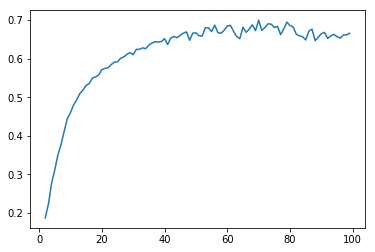

In [124]:
plt.plot(np.arange(2,max_clusters,1),silhouette)

## Hierarchical

In [132]:
max_clusters = 50
silhouette, _ = ce.u_clustering_eval(max_clusters,AgglomerativeClustering(),features)
np.argmax(silhouette)+2,np.max(silhouette)

(47, 0.65782654)

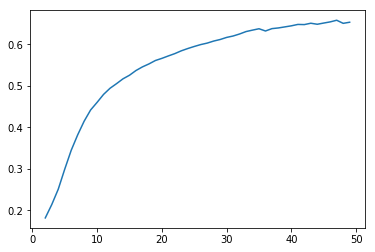

In [133]:
plt.plot(np.arange(2,max_clusters,1),silhouette)

In [166]:
pixel_trajectories= [[t[-i] for i in range(1,len(t)+1)] for t in pixel_trajectories ]

### Visualize

In [134]:
nb_clusters = 47

In [135]:
clusters = AgglomerativeClustering(n_clusters=nb_clusters).fit_predict(features)

In [136]:
ut.display_clusters_oat_i(clusters,FRAME_PATH,pixel_trajectories)

In [171]:
clusters = KMeans(n_clusters=nb_clusters, random_state = best_random_state).fit_predict(features_pca)

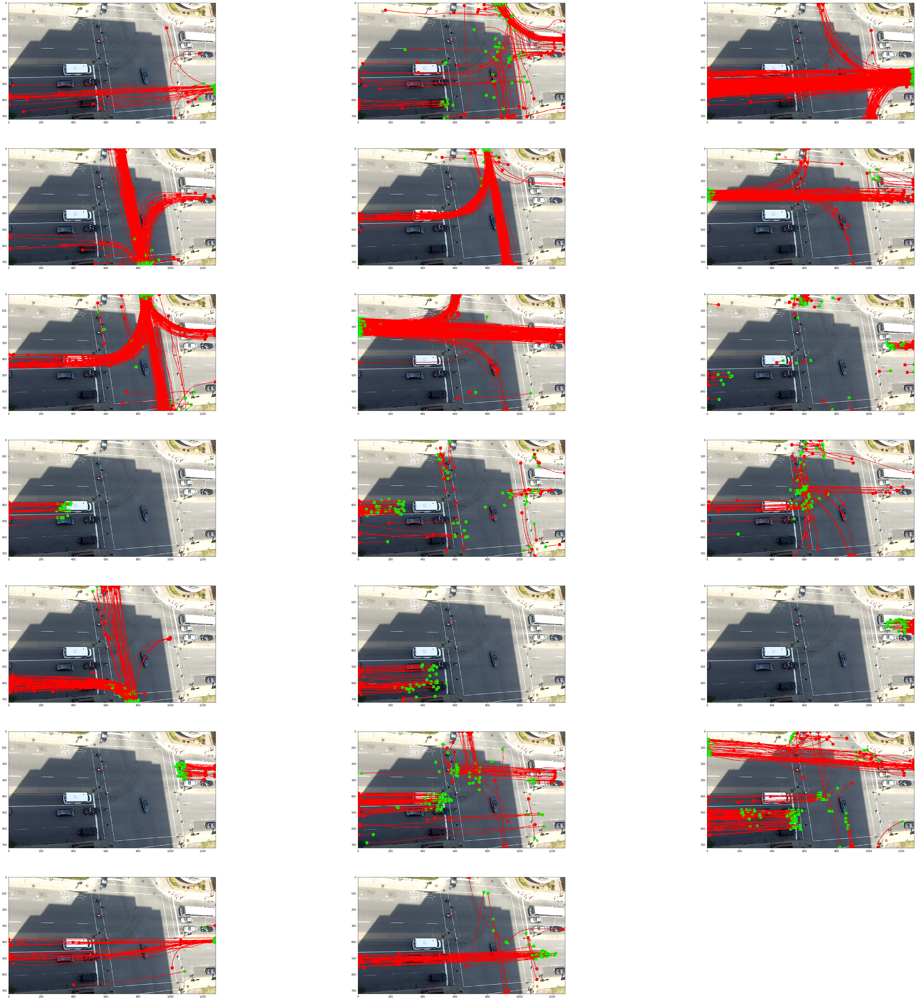

In [172]:
ut.display_clusters_oat_i(clusters,FRAME_PATH,pixel_trajectories)

In [13]:
clusters_to_keep = [3]
ids_k = [i for i,c in enumerate(clusters) if c in clusters_to_keep]


#trajectories_k,_,_ = ts.transform_original_space(trajectories[ids_k])
discretized_trajectory,nb_label,nb_row,nb_col,input_size  = ts.discretize_trajectories(trajectories[ids_k],w,h,s = 5)
input_data, sos = ts.one_hot_encode_states_eos1(nb_label,discretized_trajectory)
input_data,minmax_scaler = ts.minmax_scaling(input_data)
#encoder = s2s.seq2seq(input_data,sos,train_ = 0,input_size = input_size,output_size = input_size,hidden_size = 20,n_iters = 2000,learning_rate=0.01)
features_k = s2s.unify_trajectory_sizes(encoder,input_data,input_size = input_size)


In [14]:
features_k_pca = pca.transform(features_k)

In [16]:
max_clusters = 15
silhouette, _ = ce.u_clustering_eval(max_clusters,KMeans(),features_k_pca)
np.argmax(silhouette)+2,np.max(silhouette)

(12, 0.823085846971217)

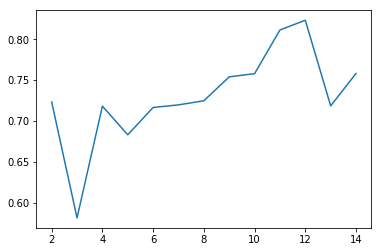

In [17]:
plt.plot(np.arange(2,max_clusters,1),silhouette)

In [30]:
nb_clusters_k = 12

In [31]:
clusters_k = KMeans(n_clusters=nb_clusters_k).fit_predict(features_k_pca)

In [32]:
#pixel_trajectories = np.array(pixel_trajectories)

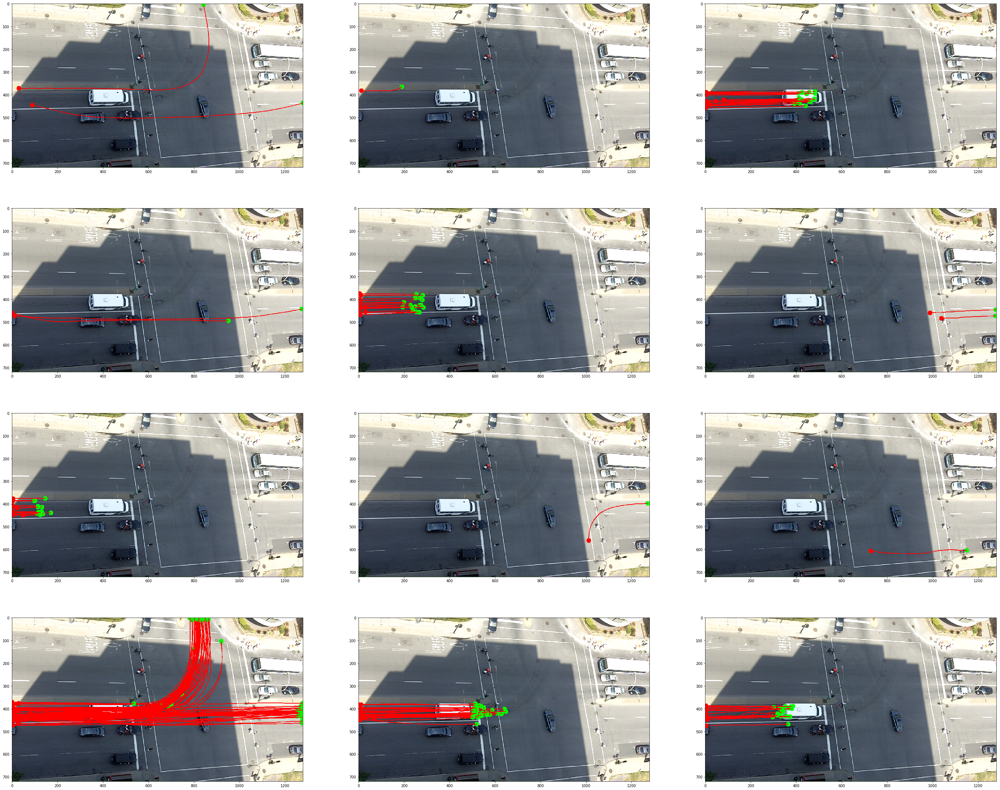

In [33]:
ut.display_clusters_oat_i(clusters_k,FRAME_PATH,pixel_trajectories[ids_k])

In [151]:
nb_clusters = 40
clusters = AgglomerativeClustering(n_clusters=nb_clusters).fit_predict(features_pca)

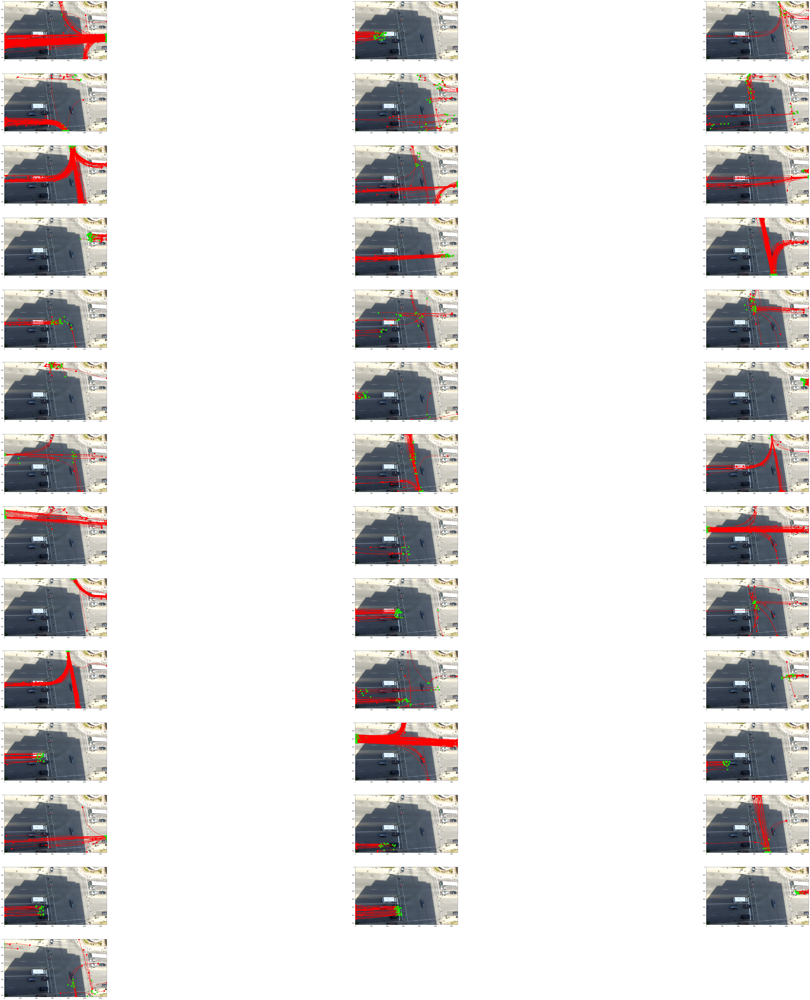

In [152]:
ut.display_clusters_oat_i(clusters,FRAME_PATH,pixel_trajectories)

In [24]:
#encoder = s2s.seq2seq(input_data,sos,input_size = input_size,output_size = input_size,hidden_size = 20,n_iters = 2000,learning_rate=0.01)